In [1]:
import quandl
import getpass
import pandas as pd
#quandl.ApiConfig.api_key = getpass.getpass()

In [2]:
companies = pd.read_csv('https://s3-eu-west-1.amazonaws.com/ih-materials/uploads/data-static/data/module-1/companies.csv')

In [3]:
companies.shape

(30, 2)

In [4]:
companies.head()

,Ticker,Company
0,AAPL,Apple Inc.
1,NFLX,"Netflix, Inc."
2,AMZN,"Amazon.com, Inc."
3,MSFT,Microsoft Corporation
4,GOOG,Alphabet Inc.


In [ ]:
#!pip install yfinance
import yfinance as yf

# Télécharger les données de Google (Alphabet)
df = yf.download("GOOG", start="1980-01-01", end="2020-01-01")

In [7]:
df.head()

Price,Close,High,Low,Open,Volume
Ticker,GOOG,GOOG,GOOG,GOOG,GOOG
Date,,,,,
2004-08-19,2.482147,2.574169,2.373798,2.473736,897427216
2004-08-20,2.679304,2.698351,2.486105,2.498721,458857488
2004-08-23,2.706267,2.807196,2.697610,2.739663,366857939
2004-08-24,2.594207,2.760689,2.562048,2.751784,306396159
2004-08-25,2.622160,2.671635,2.569717,2.596433,184645512


In [8]:
#quandl.get('WIKI/GOOG')

In [9]:
quandl.get('WIKI/AAPL')

,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
Date,,,,,,,,,,,,
1980-12-12,28.75,28.87,28.75,28.750,2093900.0,0.0,1.0,0.422706,0.424470,0.422706,0.422706,117258400.0
1980-12-15,27.38,27.38,27.25,27.250,785200.0,0.0,1.0,0.402563,0.402563,0.400652,0.400652,43971200.0
1980-12-16,25.37,25.37,25.25,25.250,472000.0,0.0,1.0,0.373010,0.373010,0.371246,0.371246,26432000.0
1980-12-17,25.87,26.00,25.87,25.870,385900.0,0.0,1.0,0.380362,0.382273,0.380362,0.380362,21610400.0
1980-12-18,26.63,26.75,26.63,26.630,327900.0,0.0,1.0,0.391536,0.393300,0.391536,0.391536,18362400.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2018-03-21,175.04,175.09,171.26,171.270,35247358.0,0.0,1.0,175.040000,175.090000,171.260000,171.270000,35247358.0
2018-03-22,170.00,172.68,168.60,168.845,41051076.0,0.0,1.0,170.000000,172.680000,168.600000,168.845000,41051076.0
2018-03-23,168.39,169.92,164.94,164.940,40248954.0,0.0,1.0,168.390000,169.920000,164.940000,164.940000,40248954.0


In [9]:
tickers = companies.Ticker.to_list()

In [17]:
def get_prices(ticker: str) -> pd.DataFrame:
    print('Retreiving prices for tickers', ticker)
    prices = quandl.get(f'WIKI/{ticker}')['Adj. Close'].reset_index()
    prices['Ticker'] = ticker
    return prices

In [18]:
get_prices('MSFT')

Retreiving prices for tickers MSFT


,Date,Adj. Close,Ticker
0,1986-03-13,0.064720,MSFT
1,1986-03-14,0.067031,MSFT
2,1986-03-17,0.068187,MSFT
3,1986-03-18,0.066454,MSFT
4,1986-03-19,0.065298,MSFT
...,...,...,...
8071,2018-03-21,92.480000,MSFT
8072,2018-03-22,89.790000,MSFT
8073,2018-03-23,87.180000,MSFT
8074,2018-03-26,93.780000,MSFT


In [20]:
lodf = list(map(get_prices, tickers))

Retreiving prices for tickers AAPL
Retreiving prices for tickers NFLX
Retreiving prices for tickers AMZN
Retreiving prices for tickers MSFT
Retreiving prices for tickers GOOG
Retreiving prices for tickers TSLA
Retreiving prices for tickers FB
Retreiving prices for tickers AAP
Retreiving prices for tickers DIS
Retreiving prices for tickers NKE
Retreiving prices for tickers UA
Retreiving prices for tickers BAC
Retreiving prices for tickers CCL
Retreiving prices for tickers CI
Retreiving prices for tickers AAL
Retreiving prices for tickers LUV
Retreiving prices for tickers WFC
Retreiving prices for tickers WMT
Retreiving prices for tickers HD
Retreiving prices for tickers ORCL
Retreiving prices for tickers IBM
Retreiving prices for tickers NCLH
Retreiving prices for tickers RCL
Retreiving prices for tickers TWX
Retreiving prices for tickers FOX
Retreiving prices for tickers F
Retreiving prices for tickers GCI
Retreiving prices for tickers XOM
Retreiving prices for tickers WWE
Retreiving p

In [21]:
lodf[-1]

,Date,Adj. Close,Ticker
0,1991-09-30,10.890339,WM
1,1991-10-01,11.211020,WM
2,1991-10-02,10.890339,WM
3,1991-10-03,11.371361,WM
4,1991-10-04,10.890339,WM
...,...,...,...
6668,2018-03-21,85.920000,WM
6669,2018-03-22,84.240000,WM
6670,2018-03-23,82.900000,WM
6671,2018-03-26,84.130000,WM


In [32]:
data = pd.concat(lodf)

In [37]:
#restructure info
dapvt = data.pivot_table(index='Date', columns='Ticker', values = 'Adj. Close')

In [39]:
dapvt.diff().pct_change() #growth rate each day

Ticker,AAL,AAP,AAPL,AMZN,BAC,CCL,CI,DIS,F,FB,...,ORCL,RCL,TSLA,TWX,UA,WFC,WM,WMT,WWE,XOM
Date,,,,,,,,,,,,,,,,,,,,,
1962-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-03-21,-2.757143,-1.611111,65.166667,-1.111833,-inf,-4.590909,-2.423611,-4.615385,-6.500000,-1.281179,...,-0.993878,-4.386364,-2.986711,-0.153846,-2.000000,-0.810345,-1.744681,-0.540000,-20.000000,-7.562500
2018-03-22,0.447154,-4.565657,-0.389169,7.120430,11.000000,0.088608,-1.834146,-3.595745,-4.181818,-4.629032,...,36.666667,1.140940,-2.242475,-10.363636,-7.000000,19.545455,3.800000,-5.521739,1.105263,-2.466667
2018-03-23,-0.269663,-0.753541,0.610309,0.285487,0.045455,1.081395,-0.216374,0.688525,-0.457143,0.222222,...,-0.026549,-0.015674,0.017497,0.640777,-1.027778,-0.314159,-0.202381,0.653846,-0.800000,-0.603896


<AxesSubplot:xlabel='Date'>

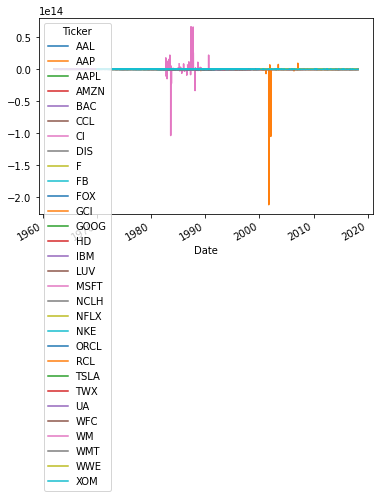

In [41]:
dapvt.diff().pct_change().plot()

In [44]:
pd.options.plotting.backend = 'plotly'

In [45]:
dapvt.diff().pct_change().plot()